In [1]:
%%capture
#%conda install -c plotly plotly=5.9.0
#%conda install pip
#%conda install twisted

#%pip install plotly==5.9.0
#%pip install twisted
#%pip install pandas
#%pip install ta    
#%pip install scikit-learn
#%pip install tensorflow
#%pip install keras
#%pip install matplotlib
#%pip install scikeras
#%pip install keras-tuner
#%pip install plotly
#%pip install nbformat
#%pip install lightgbm
#%pip install seaborn
#%pip install s3cmd
#%pip install boto3
#%pip install botocore    
#%pip install s3
#%curl https://storage.yandexcloud.net/yandexcloud-yc/install.sh | bash -s -- -a    
#%pip install huobi-sdk==2.3.3

import pandas as pd
import numpy as np    
import matplotlib.pyplot as plt
import plotly.express as px
pd.set_option('display.max_columns', None)
pd.set_option('display.expand_frame_repr', False)
pd.set_option('max_colwidth', None)



#print(f"Download completed. Local data dir: {data_dir}")

In [2]:
import os
# Downloading latest pytrade2 data
#os.system("cd ./../deploy/yandex_cloud;./download_data.sh")

In [3]:
ticker="BTC-USDT"
strategy='LgbLowHighRegressionStrategy'
target_period='15min'
data_dir=f"data/{strategy}"
#lib_dir='../.venv/lib/python3.11/site-packages'
history_days=14
comission_pct=0.012
quantity_coeff=1
#comission_pct=0


## Read strategy data


Read candles

In [4]:
from tools.DataTool import DataTool
candles = DataTool.read_last_candles(ticker, os.path.join(data_dir, "../candles"), history_days)
candles.tail()

,close_time,open_time,ticker,interval,open,high,low,close,vol
close_time,,,,,,,,,
2024-09-03 23:56:00,2024-09-03 23:56:00,2024-09-03 23:55:00,BTC-USDT,1min,57488.1,57515.3,57472.1,57479.5,6064
2024-09-03 23:57:00,2024-09-03 23:57:00,2024-09-03 23:56:00,BTC-USDT,1min,57479.5,57523.6,57458.9,57458.9,8254
2024-09-03 23:58:00,2024-09-03 23:58:00,2024-09-03 23:57:00,BTC-USDT,1min,57458.9,57473.4,57412.9,57438.5,13804
2024-09-03 23:59:00,2024-09-03 23:59:00,2024-09-03 23:58:00,BTC-USDT,1min,57429.0,57506.0,57420.3,57478.7,8704
2024-09-04 00:00:00,2024-09-04 00:00:00,2024-09-03 23:59:00,BTC-USDT,1min,57478.6,57519.1,57461.6,57487.0,8838


Read Buy/Sell signals with extended data

In [5]:
from tools.DataTool import DataTool
from pathlib import Path

def read_last_data(pattern, days=1):
    """ Read last days' files to one dataframe """
    xy_dir = Path(data_dir, 'Xy')
    files = sorted([f for f in os.listdir(xy_dir) if pattern in f])
    df = pd.concat([pd.read_csv(Path(xy_dir, fname), parse_dates=[0]) for fname in files[-days:]])
    print(f'Read {pattern} dataframe with shape {df.shape}  from {df.index.min()} to {df.index.max()}')
    return df

def read_signal(days = 1):
    xy_dir = Path(data_dir, 'Xy')
    files = sorted([f for f in os.listdir(xy_dir) if "signal_ext" in f])
    df = pd.concat([pd.read_csv(Path(xy_dir, fname), parse_dates=[0]) for fname in files[-days:]])
    df = df.set_index("datetime")
    print(f'Read signal_ext dataframe with shape {df.shape}  from {df.index.min()} to {df.index.max()}')
    
    #df = read_last_data('signal_ext', days)
    return df

signal_df = read_signal(days=history_days)
print(signal_df['signal'].value_counts())
signal_df.tail()


Read signal_ext dataframe with shape (33829, 17)  from 2024-08-08 00:00:31.500670 to 2024-08-21 21:52:28.095926
signal
 0    23359
-1     5689
 1     4781
Name: count, dtype: int64


,signal,sl,tp,price,fut_low,fut_high,signal_buy,profit_buy,loss_buy,buy_ratio,signal_sell,profit_sell,loss_sell,sell_ratio,tr_delta,status,open_price
datetime,,,,,,,,,,,,,,,,,
2024-08-21 21:50:02.951902,1,61090.0,61422.1,61196.6,61151.1,61422.1,True,210.8,60.2,3.5,False,30.8,240.2,0.1,NaN,order_not_created,NaN
2024-08-21 21:50:39.621153,1,61090.0,61422.1,61196.6,61151.1,61422.1,True,210.8,60.2,3.5,False,30.8,240.2,0.1,NaN,order_not_created,NaN
2024-08-21 21:51:15.791919,1,61103.1,61412.5,61199.9,61164.3,61412.5,True,197.9,50.3,3.9,False,20.9,227.2,0.1,NaN,order_not_created,NaN
2024-08-21 21:51:52.601019,1,61103.1,61412.5,61199.9,61164.3,61412.5,True,197.9,50.3,3.9,False,20.9,227.2,0.1,NaN,order_not_created,NaN
2024-08-21 21:52:28.095926,1,61103.1,61412.5,61199.9,61164.3,61412.5,True,197.9,50.3,3.9,False,20.9,227.2,0.1,NaN,order_not_created,NaN


Read account dataframe for last 14 days with shape (530, 2)  from 2024-07-01 01:31:58.196925 to 2024-08-21 01:27:46.562596


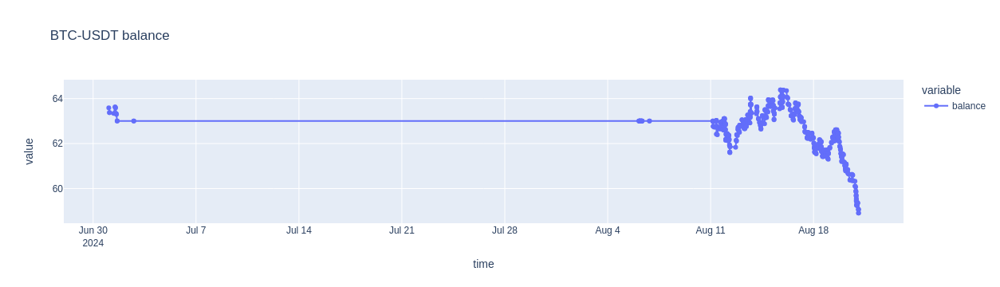

In [6]:
# Remove plotly warnings
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

def read_account(days=1):
    dir_ = Path(data_dir, 'account')
    files = sorted([f for f in os.listdir(dir_)])
    df = pd.concat([pd.read_csv(Path(dir_, fname), parse_dates=[0]) for fname in files[-days:]])
    df = df.set_index("time")
    print(f'Read account dataframe for last {days} days with shape {df.shape}  from {df.index.min()} to {df.index.max()}')
    
    #df = read_last_data('signal_ext', days)
    return df    
balance = read_account(history_days)
px.line(balance["balance"], title=f"{ticker} balance").update_traces(mode='lines+markers').show()

## Profit

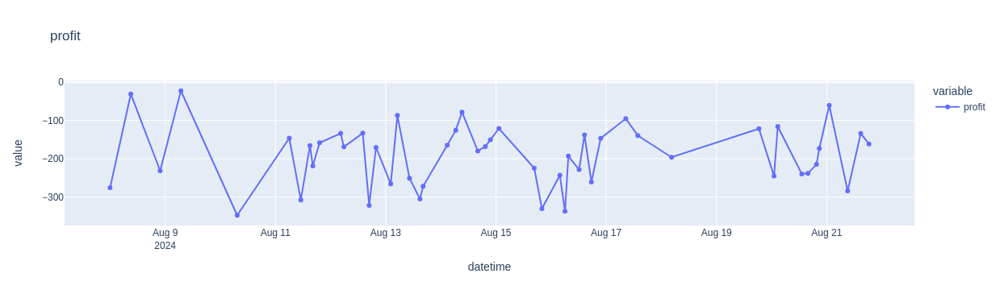

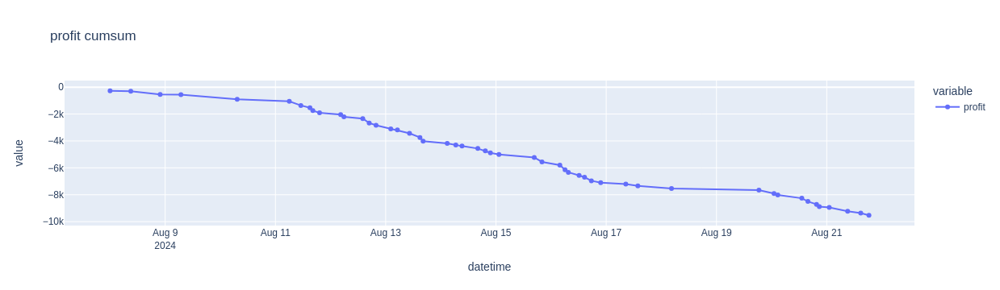

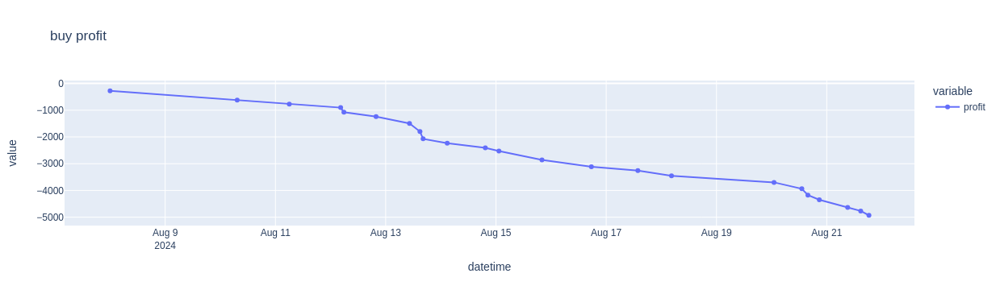

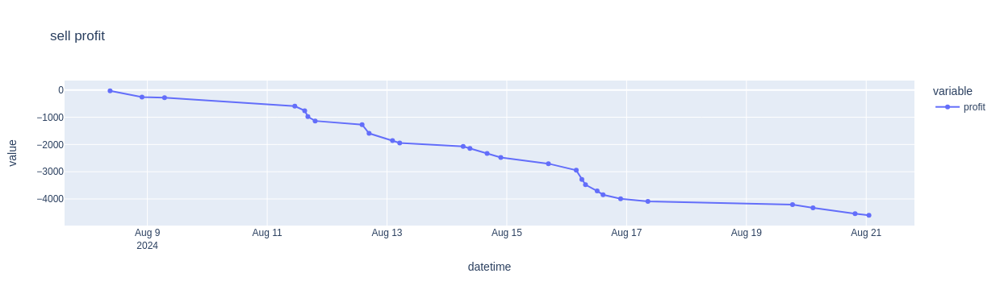

,signal,raw_profit,profit
datetime,,,
2024-08-20 20:46:22.627,1,-158.9,-173.151200
2024-08-21 01:05:14.459,-1,-46.6,-60.757960
2024-08-21 09:06:12.744,1,-269.8,-284.029288
2024-08-21 14:47:33.800,1,-119.8,-134.129728
2024-08-21 18:21:49.285,1,-147.0,-161.443584


In [7]:
import plotly.express as px
import warnings
# Supress pandas+plotly warning
warnings.simplefilter(action='ignore', category=FutureWarning)

def calc_profit(y_signal, fut_lohi, candles, target_period, signal_groups=False, timeout='1h', trailingstop=False):
    real_lohi = fut_lohi[['fut_low', 'fut_high']]
    real_lohi.columns=['fut_low_real', 'fut_high_real']

    y_signal = pd.merge_asof(y_signal.set_index(y_signal.index.astype('datetime64[ms]')),
                             real_lohi.set_index(real_lohi.index.astype('datetime64[ms]')), 
                             left_index=True, right_index=True, direction = 'backward')
    
    # Set profit/loss for 1 and -1, because 0 is excluded before
    loss = (y_signal['sl']-y_signal['price']).abs()
    profit = (y_signal['tp']-y_signal['price']).abs()
    if trailingstop:
        profit-=loss

    is_buy_profit = ((y_signal['signal']==1) 
                     & (y_signal['sl']< y_signal['fut_low_real'])
                     & (y_signal['tp'] <= y_signal['fut_high_real'])
                    )
    is_buy_loss = (y_signal['signal']==1) & (~is_buy_profit)

    is_sell_profit = ((y_signal['signal']==-1) 
                     & (y_signal['sl'] > y_signal['fut_high_real']) 
                     & (y_signal['tp'] >= y_signal['fut_low_real']))
    is_sell_loss = (y_signal['signal']==-1) & (~is_sell_profit)

    # Calc profit
    profit_df = y_signal[['signal']].copy()
    profit_df.loc[is_buy_profit | is_sell_profit,['raw_profit']] = profit
    profit_df.loc[is_buy_loss | is_sell_loss, 'raw_profit'] = -loss
    profit_df['raw_profit'] = profit_df['raw_profit'].fillna(0)
    # Minus open and close comissions
    profit_df['profit'] = profit_df['raw_profit'] - y_signal['signal'].abs()*y_signal['price']*comission_pct*0.01*2
    
    # Filter buy/sell  only
    if signal_groups:
        profit_df = profit_df.loc[(profit_df['signal']!=0) & (profit_df['signal'].diff())]
    else:
        profit_df = profit_df[profit_df['signal'] != 0]
    if timeout:
        timeout_delta = pd.Timedelta(timeout)
        is_timeout_denied = (profit_df.index.diff() < timeout_delta) & (profit_df['profit'].shift(1) < 0)
    
        while is_timeout_denied.sum():
            is_timeout_denied = (profit_df.index.diff() < timeout_delta) & (profit_df['profit'].shift(1) < 0)
            profit_df = profit_df[~is_timeout_denied]

    return profit_df

    
fut_lohi = candles[['low', 'high']].shift(-1).dropna().rename(columns={'low': 'fut_low', 'high': 'fut_high'})
profit_df = calc_profit(signal_df, fut_lohi, candles, target_period, False , '1h', True)
profit_df = calc_profit(signal_df, fut_lohi, candles, target_period, False , '1h', True)

px.line(profit_df[['profit']], title='profit').update_traces(mode='lines+markers').show()
px.line(profit_df[['profit']].cumsum(), title='profit cumsum').update_traces(mode='lines+markers').show()

px.line(profit_df.loc[profit_df['signal']==1, ['profit']].cumsum(), title='buy profit').update_traces(mode='lines+markers').show()
px.line(profit_df.loc[profit_df['signal']==-1, ['profit']].cumsum(), title='sell profit').update_traces(mode='lines+markers').show()
profit_df.tail()

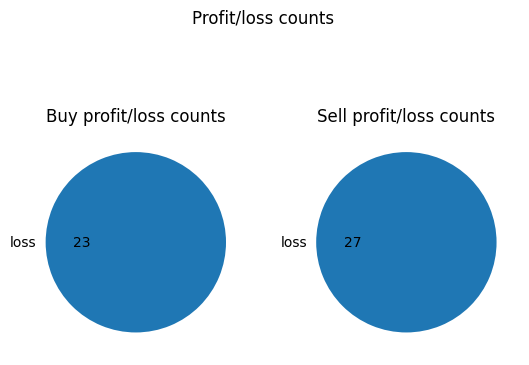

In [8]:
def plot_profit_pie(profit_df):
    fig, (ax1, ax2) = plt.subplots(1, 2) 
    df = profit_df.copy()
    df.loc[df['profit'] > 0, 'profit_status'] = 'profit'
    df.loc[df['profit'] < 0, 'profit_status'] = 'loss'
    vc1 = df.loc[df['signal'] == 1, 'profit_status'].value_counts()
    ax1.pie(vc1, labels=vc1.keys(), autopct= lambda x: '{:.0f}'.format(x*vc1.sum()/100))
    ax1.set_title('Buy profit/loss counts')
                  
    vc2 = df.loc[df['signal'] == -1, 'profit_status'].value_counts()
    ax2.pie(vc2, labels=vc2.keys(), autopct= lambda x: '{:.0f}'.format(x*vc2.sum()/100))
    ax2.set_title('Sell profit/loss counts')
    fig.suptitle('Profit/loss counts')
    plt.show()

plot_profit_pie(profit_df)
    

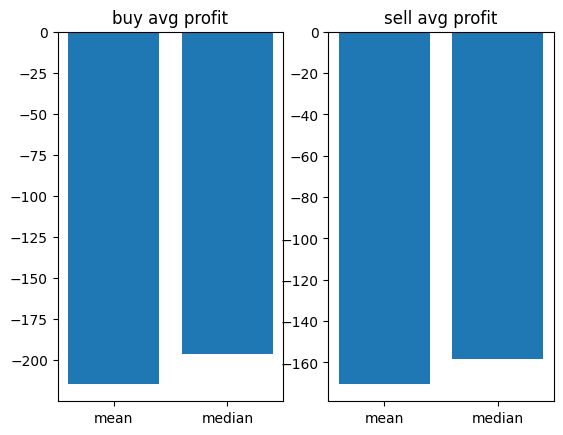

In [9]:

def plot_avg_profit(profit_df):
    fig, (ax1, ax2) = plt.subplots(1, 2) 
    buy_data = {'mean': profit_df[profit_df['signal'] == 1]['profit'].mean(), 
                'median': profit_df[profit_df['signal'] == 1]['profit'].median()}
    sell_data = {'mean': profit_df[profit_df['signal'] == -1]['profit'].mean(), 
                'median': profit_df[profit_df['signal'] == -1]['profit'].median()}
    ax1.bar(*zip(*buy_data.items()))
    ax1.set_title('buy avg profit')
    ax2.bar(*zip(*sell_data.items()))
    ax2.set_title('sell avg profit')
    plt.show()


plot_avg_profit(profit_df)

## Signal counts

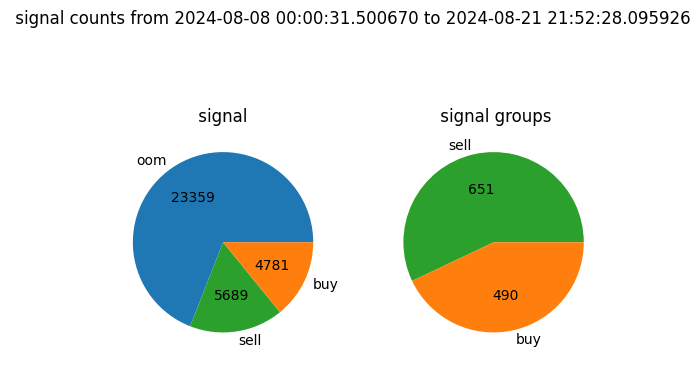

In [10]:
import matplotlib.pyplot as plt

def plot_value_counts(ax, df, col, grouped, name):
    signals = df[col]
    #vc = signals[signals.diff() != 0].value_counts()
    vc = df[col].value_counts() if not grouped else signals[(signals.diff() != 0) & (signals != 0)].value_counts()
    label_map={0:'oom', 1:'buy', -1: 'sell'}
    color_map={'oom':'C0', 'buy': 'C1', 'sell': 'C2'}
    labels = [ label_map[signal] for signal in vc.index.tolist()]
    colors = [color_map[key] for key in labels]
    ax.pie(vc, labels = labels,  autopct= lambda x: '{:.0f}'.format(x*vc.sum()/100), colors = colors)
    tag = 'groups' if grouped else ''
    ax.set_title(f"{name} {col} {tag}")
    
def plot_signal_counts(df, name = ''):
    #df = df.groupby('close_time').agg('last')
    fig, (ax1, ax2) = plt.subplots(1, 2) 
    plot_value_counts(ax1, df, 'signal', grouped = False, name=name)
    plot_value_counts(ax2, df, 'signal', grouped = True, name=name)
    fig.suptitle(f'{name} signal counts from {df.index.min()} to {df.index.max()}')
    plt.show()

plot_signal_counts(signal_df)

## Profits and losses

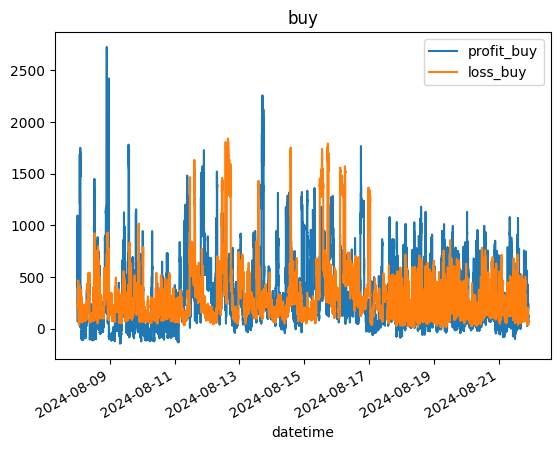

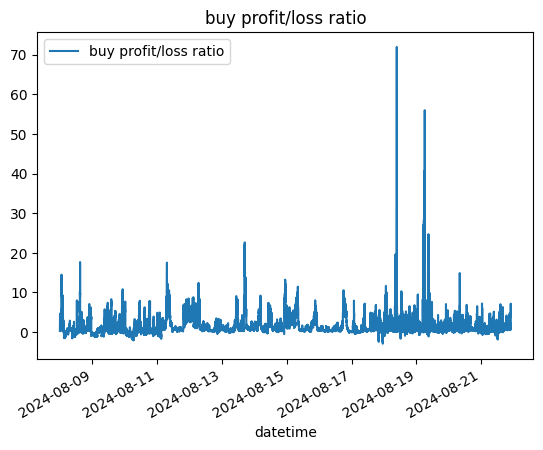

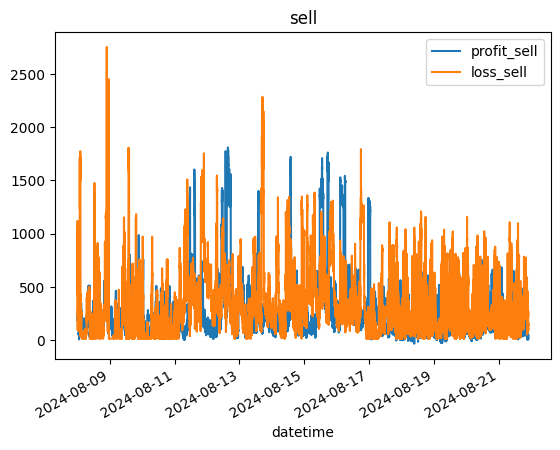

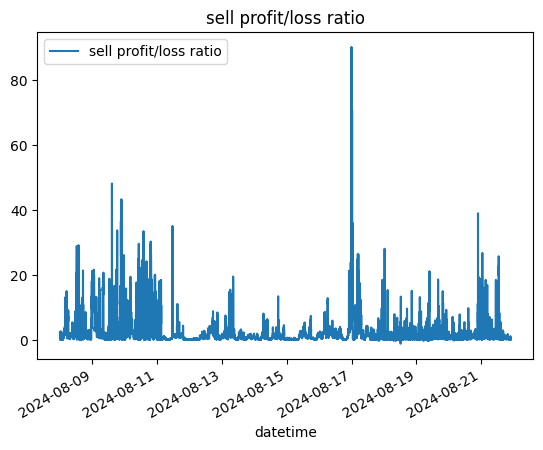

In [11]:
def plot_profit_loss(signalname):
    signal_df[[f'profit_{signalname}', f'loss_{signalname}']].plot(title=signalname)
    plt.show()
    ratio_df = pd.DataFrame(index=signal_df.index)
    ratio_df[f'{signalname} profit/loss ratio'] = (signal_df[f'profit_{signalname}']/signal_df[f'loss_{signalname}'])
    ratio_df.plot(title=f'{signalname} profit/loss ratio')
    plt.show()
plot_profit_loss('buy')
plot_profit_loss('sell')

## Profit/loss ratio

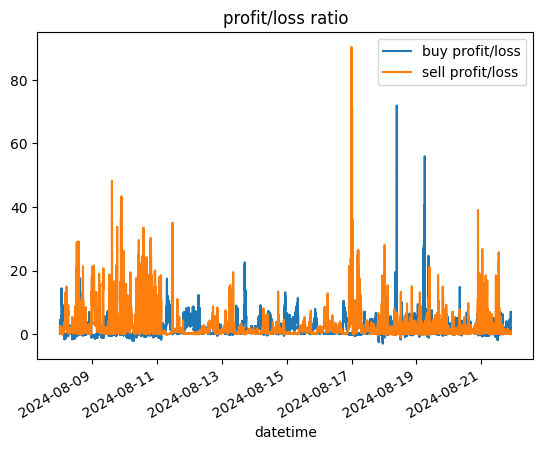

In [12]:
ratio_df = pd.DataFrame(index=signal_df.index)
ratio_df['buy profit/loss'] = (signal_df['profit_buy']/signal_df['loss_buy'])
ratio_df['sell profit/loss'] = (signal_df['profit_sell']/signal_df['loss_sell'])
ratio_df.plot(title='profit/loss ratio')

plt.show()


In [13]:
signal_df['status'].dropna().tail()


datetime
2024-08-21 21:50:02.951902    order_not_created
2024-08-21 21:50:39.621153    order_not_created
2024-08-21 21:51:15.791919    order_not_created
2024-08-21 21:51:52.601019    order_not_created
2024-08-21 21:52:28.095926    order_not_created
Name: status, dtype: object

## Prices

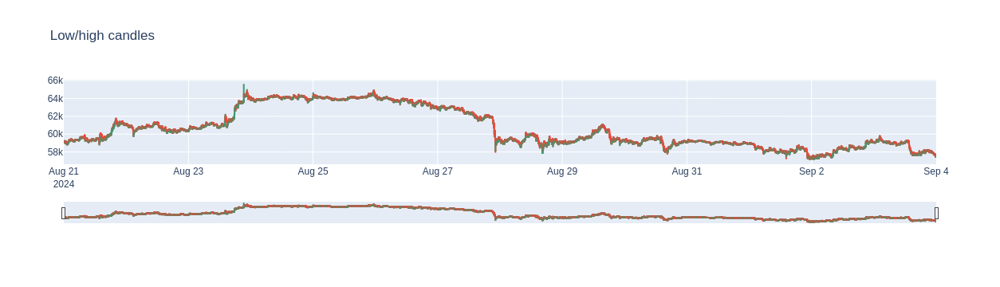

In [14]:
import plotly as py
from plotly import graph_objects as go
import pandas as pd
import numpy as np
import datetime

def plot_candles_figure(signal_df: pd.DataFrame, candles: pd.DataFrame, period: str)->pd.DataFrame:
    """
    Form plotly candlestick chart with buy/sell marks on it
    """
    df = candles
    #df=signal_df.resample(period).agg('last')
    #df = df.merge(candles)
    
    #df=clean_candles(df)
    fig = go.Figure(data=[ \
                        go.Candlestick(\
                            x=df.index,\
                            open=df['close'].shift(1),\
                            high=df['high'],\
                            low=df['low'],\
                            close=df['close'])
                         ])
    

    fig.update_layout(title_text='Low/high candles')                         
    fig.show()

plot_candles_figure(signal_df, candles,  '5min')

Read y_pred dataframe with shape (4448, 4)  from 0 to 4447


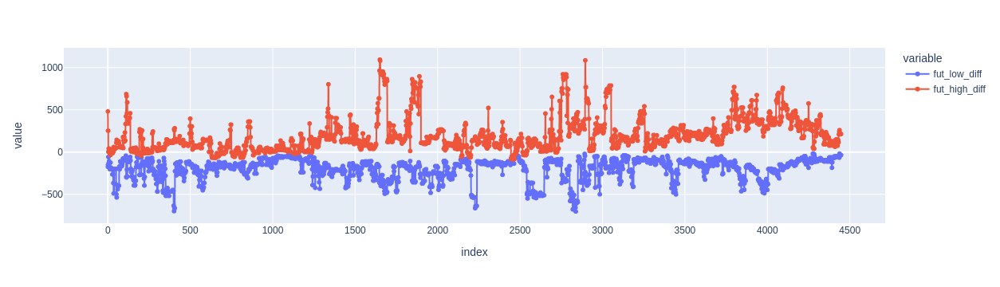

In [15]:
def analyze_y():
    df = read_last_data('y_pred', 1)#.set_index('datetime')
    px.line(df[['fut_low_diff', 'fut_high_diff']]).update_traces(mode='lines+markers').show()

#def analyze_raw_candles()
analyze_y()


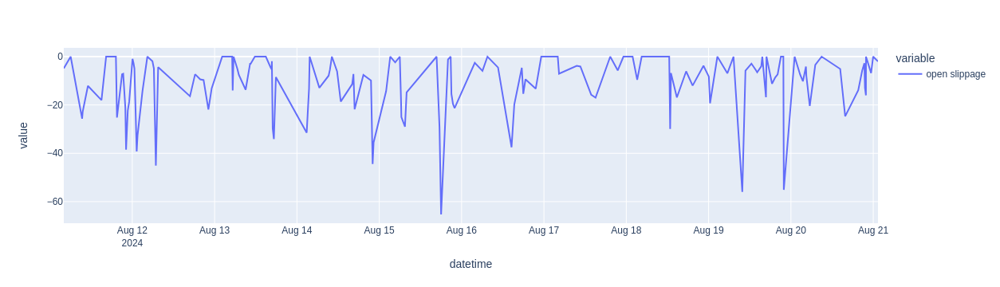

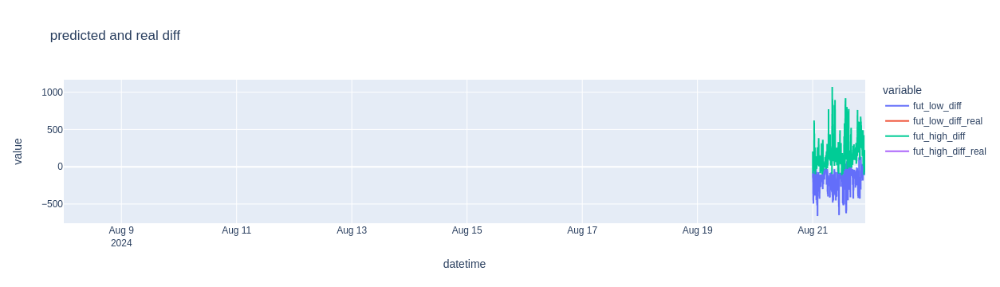

In [16]:
def analyze_signal_df():
    df = signal_df.copy()
    c = candles[['low','high']]
    df = pd.merge_asof(df, candles, left_index=True, right_index=True, direction='backward')
    df['fut_low_diff'] = df['fut_low'] - df['low']
    df['fut_high_diff'] = df['fut_high'] - df['high']
    df['fut_low_diff_real'] = candles['low'].shift(-1) - candles['low']
    df['fut_high_diff_real'] = candles['high'].shift(-1) - candles['high']
    df = df[['fut_low_diff', 'fut_low_diff_real', 'fut_high_diff', 'fut_high_diff_real']]
    px.line(df, title = "predicted and real diff").show()

def analyze_slippage():
    df = pd.DataFrame()
    df['open slippage'] = ((signal_df['price'] - signal_df['open_price']) * -signal_df['signal']).dropna()
    px.line(df).show()

analyze_slippage()
analyze_signal_df()    

## Real trading

### Trades

Get trades from data/LgbLowHighRegressionStrategy/LgbLowHighRegressionStrategy.db


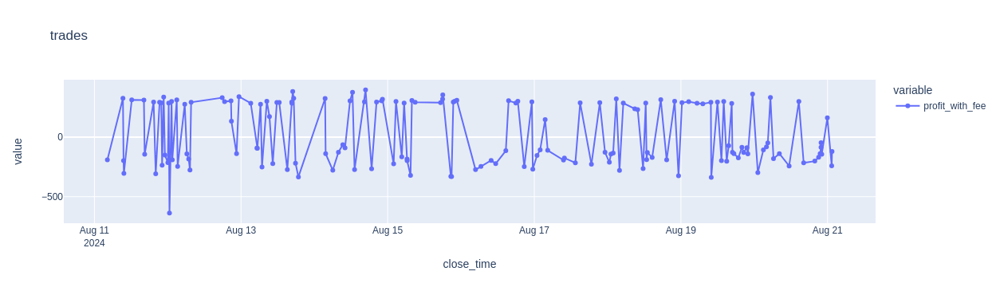

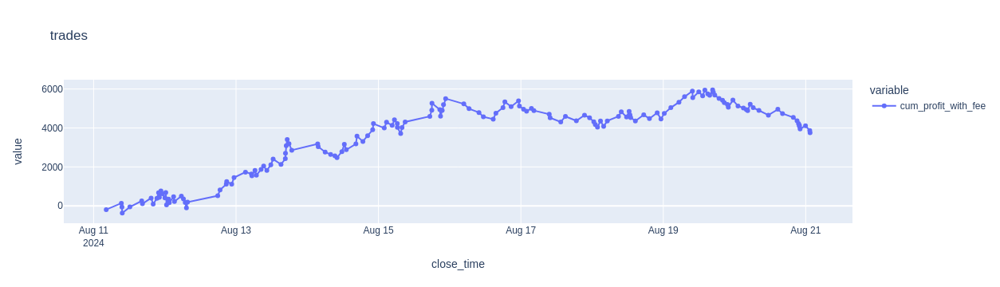

In [17]:
import pandas as pd
import numpy as np

def get_trades(data_dir: str, strategy: str):
    import sqlite3
    db_path=f"{data_dir}/{strategy}.db"
    fee=0.00012
    print(f"Get trades from {db_path}")

    with sqlite3.connect(db_path) as conn:
        trades=pd.read_sql_query("SELECT * FROM trade ORDER BY open_time",conn,
                                 parse_dates=["open_time", "close_time"])#.set_index("open_time", drop=False)
    trades["profit"] = np.where(trades["side"] == "BUY", 
                                (trades["close_price"]-trades["open_price"])*trades["quantity"]*quantity_coeff,
                                (trades["open_price"]-trades["close_price"])*trades["quantity"]*quantity_coeff,
                               )
    trades["cum_profit"] = trades["profit"].cumsum()
    trades["profit_with_fee"] = trades["profit"] - fee*(trades["open_price"] + trades["close_price"])*trades["quantity"]*quantity_coeff
    trades["cum_profit_with_fee"] = trades["profit_with_fee"].cumsum()
    trades=trades.set_index("close_time", drop=False)
    return trades

trades=get_trades(data_dir, strategy)
px.line(trades["profit_with_fee"], title="trades").update_traces(mode='lines+markers').show()
px.line(trades["cum_profit_with_fee"], title="trades").update_traces(mode='lines+markers').show()

In [20]:
# Install a conda package in the current Jupyter kernel
#%conda install -c plotly plotly=5.9.0
# Draw candlechart
import plotly as py
from plotly import graph_objects as go
import pandas as pd
import numpy as np
import datetime

def plot_trades_on_candles(candles: pd.DataFrame, trades: pd.DataFrame)->pd.DataFrame:
    """
    Form plotly candlestick chart with buy/sell marks on it
    """
    
    df=candles.copy()
    #df=clean_candles(df)
    fig = go.Figure(data=[ \
                        go.Candlestick(\
                            x=df.index,\
                            open=df['open'],\
                            high=df['high'],\
                            low=df['low'],\
                            close=df['close'])
                         ])

    # Customize ay to distribute captions by y so they do not overlap by x
    ay,aymax,aystep=0,50,10
    #start_time=df.open_time.min()
    # Annotate buy, sell on the chart
    for i,trade in trades[(~trades["open_time"].isna()) & \
                           (trades["open_time"] > df.open_time.min()) & \
                           (~trades.close_time.isna()) & \
                           (~trades.open_price.isna()) & \
                           (~trades.close_price.isna()) \
                         ].iterrows():
        ay=(ay+aystep)%aymax
        color='green' if trade['side']=="BUY" else 'red'

        # Draw open order
        open_text='buy' if trade['side']=="BUY"  else 'sell'
        open_hover=f"{trade['open_time']} {open_text} at {str(trade['open_price'])}, sl={trade['stop_loss_price']}, tp={trade['take_profit_price']}"
        fig.add_annotation(x=trade['open_time'], \
                           y=trade['open_price'],\
                           text=open_text,\
                           hovertext=open_hover,\
                           showarrow=True,arrowhead=5,arrowcolor=color,ay=-ay,arrowwidth=2,
                           font={'color':color}
                         )
    for i,trade in trades[(~trades.close_time.isna()) & \
                          (~trades.open_price.isna()) & \
                          (~trades.close_price.isna()) & \
                          (trades.close_time > df.close_time.min())].iterrows():
        color='green' if trade['side']=="BUY" else 'red'

        # Draw close order
        #profit = trade["close_price"]-trade["open_price"] if trade["close_price"] else None
        status= f", profit: {round(trade.profit, 10)}" if trade.profit else ""
        close_text=f"close {trade['side'].lower()}"
        close_hover=f"{trade['close_time']} {close_text} at {str(trade['close_price'])}{status}"
        fig.add_annotation(x=trade['close_time'], \
                           y=trade['close_price'],\
                           text=close_text,\
                           hovertext=close_hover,\
                           showarrow=True,arrowhead=5,arrowcolor=color,ay=-ay,arrowwidth=2,\
                           font={'color':color}
                         )
        fig.update_layout(title="Trades")
        fig.update_layout(height=700)
        
    fig.show()

#plot_trades_on_candles(candles, trades)



### Account

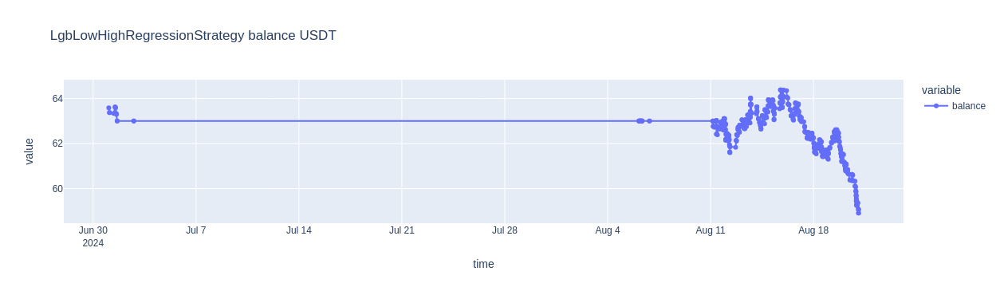

In [19]:
import plotly.express as px
import seaborn as sns
from matplotlib import pyplot as plt
import seaborn as sns

plot_figsize=(10,5)
sns.set_style("darkgrid")
from datetime import datetime


# def get_balance(strategy: str):
#     """ Read balance history from data"""
    
#     data_dir=f"../data"
#     env_dir="yandex-cloud"
#     account_dir=f"{data_dir}/{env_dir}/{strategy}/account"
#     print(f"Reading balance files from {account_dir}")
#     #file_path = sorted([f for f in os.listdir(account_dir) if f.endswith(f"{symbol}_{name}.csv")])[-1]
#     files = sorted([f for f in os.listdir(account_dir) if f.endswith(f".csv.zip")])
#     dfs = [pd.read_csv(f"{account_dir}/{f}", parse_dates=True, index_col="time") for f in files]
#     df = pd.concat(dfs).sort_index() if dfs else pd.DataFrame(data=[{"datetime": datetime.now(), "balance": 0}], columns=["datetime","balance"])
#     #df = pd.concat([df for df in dfs if not df.empty]).sort_index()
#     df["datetime"] = df.index
#     df = df[df['balance'].diff()!=0]
#     return df[df.index >= min(signal_df.index)]

#balance = get_balance(strategy)
px.line(balance["balance"], title=f"{strategy} balance USDT").update_traces(mode='lines+markers').show()